<a href="https://colab.research.google.com/github/sid1336/Computational-Physics-Projects/blob/main/Quantum_tunneling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Quantum Tunneling, Part 1  link:[Quantum tunneling](https://physicspython.wordpress.com/2019/10/27/quantum-tunneling-part-3/)

In this Python project, we will look at quantum tunneling. Even if you are completely new to quantum mechanics, you must have heard of this mysterious, quantum property of matter. Particles can, apparently, move through solid barriers! What is this quantum woo all about? This, we will find out by solving a standard textbook problem — that of a one-dimensional potential barrier. Our goal will be to derive the tunneling probability. We will then implement a simulation of a particle near such a potential barrier and look at the numerical solution of the problem.

## The Schrödinger Equation

What do we do when we want to study the evolution of a macroscopic physical system — a bullet, a ping-pong ball, the Solar system — in time? We reach for an equation of motion, such as the second law of Newton. To describe a system in classical mechanics we only need the equation of motion and two pieces of data: the initial position, and the initial velocity of all parts of the system. Armed with these, we can predict the state of the system at any arbitrary point in time.

Quantum mechanics differs from classical mechanics in the equation of motion and the required initial conditions. A quantum particle is described not by its position and velocity, but rather by a complex function — called the wave function — spread out over all of space. Its motion (or change), in turn, is dictated by Schrödinger’s equation of motion:

$$
\hat{H}\Psi(\mathbf{r}, t) = i \hbar \frac{\partial}{\partial\,t} \Psi
$$

The capital H with the fancy hat is the Hamiltonian operator. It is related to the Hamiltonian we discussed some time ago in relation to the classical Hamiltonian description of the double pendulum. The difference here is that instead of just a scalar number (which can be interpreted as the total energy of the system in certain cases), it is an operator — a mathematical entity that acts on a wave function and changes it, producing a different wave function.

Furthermore, the above equation is clearly a first-order partial differential equation in time. Hence, only the initial state of the system is required as the initial condition.

Finally, it would be nice to know the shape of the Hamiltonian operator. Generally, one can go from classical mechanics to quantum mechanics just by putting hats on the quantities (yes, it’s often that easy). For example, a classical particle in a spatially changing potential (think electric potential energy or gravitational potential) has the following Hamiltonian:

$$
H = \frac{\mathbf{p}^2}{2m} + V(\mathbf{r})
$$

The corresponding quantum-mechanical Hamiltonian operator is:

$$
\hat{H} = \frac{\hat{\mathbf{p}}^2}{2m} + \hat{V}(\mathbf{r})
$$

Now we just plug in the expressions of the position and momentum operators in position space (read regular space):

$$
\hat{\mathbf{r}} = r \quad \text{and} \quad \hat{\mathbf{p}} = -i \hbar \nabla
$$

We find:

$$
\hat{H} = - \frac{\hbar^2}{2m}\nabla^2 + V(\mathbf{r})
$$

Our Schrödinger equation therefore looks like this:

$$
\left[-\frac{\hbar^2}{2m}\nabla^2 + V(\mathbf{r})\right]\Psi = i \hbar \frac{\partial}{\partial\,t} \Psi
$$

What are its solutions \( \Psi \)? Since the left-hand side of the equation is independent of time, we could try to look for a separated solution. Moreover, the right-hand side would then represent a simple first-order differential equation in time. It makes sense, then, to look for a solution in the form:

$$
\Psi(\mathbf{r}, t) = \psi(\mathbf{r})e^{-i\frac{E}{\hbar}t}
$$

Plugging this Ansatz into our equation we have that:

$$
e^{-i\frac{E}{\hbar}t}\left[\frac{\hbar^2}{2m}\nabla^2 + V(\mathbf{r})\right]\psi(\mathbf{r}) = i \hbar \psi(\mathbf{r}) \frac{\partial}{\partial\,t} e^{-i\frac{E}{\hbar}t}
$$

Carrying out the time derivation and dividing by the complex exponential we get:

$$
\left[-\frac{\hbar^2}{2m}\nabla^2 + V(\mathbf{r})\right]\psi(\mathbf{r}) = E \psi(\mathbf{r})
$$

This is called the time-independent Schrödinger equation. Its solutions are called eigenstates — they represent wave functions that, upon action of the Hamiltonian operator, remain identical up to a scalar multiplicative coefficient: the eigenvalue. This scalar value can, in turn, be identified with the total energy corresponding to the state. In simpler terms, think of the eigenstates as the basic building blocks of the solution, while the eigenvalues are the corresponding energies. Let us now solve the Schrödinger equation for a model system illustrating the essence of quantum tunneling!

## Rectangular Potential Barrier

Consider a one-dimensional potential barrier described by a potential \( V(x) \):

$$
V(x) = \begin{cases}
0 & \text{if}\ x < 0 \\
V_0 & \text{if}\ 0 \leq x \leq a \\
0 & \text{if}\ x > a
\end{cases}
$$

This naturally splits the physical system into three parts. Let us designate the solution for all \( x < 0 \) by \( \psi_{\text{I}}(x) \), for \( 0 \leq x \leq a \) by \( \psi_{\text{II}}(x) \), and for all even greater \( x \) by \( \psi_{\text{III}}(x) \).

The time-independent Schrödinger equation for region \(\text{I}\) is:

$$
-\frac{\hbar^2}{2m}\frac{\partial^2}{\partial x^2}\psi_{\text{I}}(x) = E \psi_{\text{I}}(x)
$$

the solution of which is trivial. In the absence of a potential, the solution is a linear combination of sines and cosines. However, we might instead prefer the complex exponential form:

$$
\psi_{\text{I}}(x) = A_r e^{ikx} + A_l e^{-ikx}
$$

Plugging this into the left-hand side of our equation of motion we find that:

$$
-\frac{\hbar^2}{2m}\frac{\partial^2}{\partial x^2}\left( A_r e^{ikx} + A_l e^{-ikx} \right) = -\frac{\hbar^2}{2m} \left(-k^2A_re^{ikx} - k^2 A_l e^{-ikx}\right) = \frac{\hbar^2k^2}{2m} \psi_{\text{I}}(x)
$$

and thus:

$$
\frac{\hbar^2k^2}{2m} \psi_{\text{I}}(x) = E\psi_{\text{I}}(x) \quad \Rightarrow \quad k = \sqrt{\frac{2mE}{\hbar^2}}
$$

The solution in region \(\text{III}\) is, naturally, very similar:

$$
\psi_{\text{III}}(x) = C_r e^{ikx} + C_l e^{-ikx}
$$

Finally, we can look at the region of space inside the potential barrier. While the potential here is still constant, it is non-zero. This, however, only results in a change of the wavenumber; the solution itself is mathematically the same as in the other regions. We have that:

$$
\psi_{\text{II}}(x) = B_r e^{iqx} + B_l e^{-iqx}
$$

where:

$$
q = \sqrt{\frac{2m(E - V_0)}{\hbar^2}}
$$

How can we interpret the above solution? In the regions to both sides of the potential barrier, the solution represents a superposition of harmonic waves traveling in either direction. Inside the potential barrier, the solution depends on the energy of the particle compared to the barrier height. If \( E > V_0 \), the particle “flies above” the barrier. This has a direct analogy in classical physics, like a ball flying above a physical wall. However, if \( E < V_0 \), the wavenumber \( q \) is imaginary, and the solution becomes a superposition of real exponentials. While exponentials are quickly decreasing functions, they still lead to a non-zero wave function (and thus probability density) inside the potential barrier! Particles flying through walls!

The solution presented just now includes several free parameters. In total, there are seven of them: \( A_r,\, A_l,\, B_r,\, B_l,\, C_r,\, C_l \), and the energy of the particle \( E \). On the other hand side, the wave function has to satisfy certain boundary conditions. For one thing, it must be a smoothly varying function of the spatial coordinate. Hence, we get two continuity conditions on either side of the barrier. For another, the derivative of a wave function must also be continuous. Both the continuity of the wave function and that of its derivative, stem from the mathematical structure of the Schrödinger equation — it is a second-order differential equation in space. As long as the potential is finite, both continuity conditions must hold. Long story short, this gives us another two boundary conditions. Finally, we have the normalization condition. Unlike in the case of spatially confined systems, where the integral of the wave function is a finite number we can normalize, here we must use a different normalization criterion. However, the exact choice does not matter. The important point is that we get a fifth constraint.

This leaves us with 7 parameters and 5 constraints. Hence, the energy spectrum of the solution is continuous and doubly degenerate. In other words: for any choice of energy \( E \), there exist two solutions, representing a particle moving in either direction.

Now, let’s see where we stand. The solution to the problem is:

$$
\begin{aligned}
\psi_{\text{I}}(x) &= A_r e^{ikx} + A_l e^{-ikx} \\
\psi_{\text{II}}(x) &= B_r e^{iqx} + B_l e^{-iqx} \\
\psi_{\text{III}}(x) &= C_r e^{ikx} + C_l e^{-ikx}
\end{aligned}
$$

The continuity of the wave function and of its derivative yields four boundary conditions:

$$
\begin{aligned}
\psi_{\text{I}}(0) &= \psi_{\text{II}}(0) \\
\left. \frac{\partial\psi_{\text{I}}}{\partial x}\right|_0 &= \left. \frac{\partial \psi_{\text{II}}}{\partial x}\right|_0 \\
\psi_{\text{II}}(a) &= \psi_{\text{III}}(a) \\
\left. \frac{\partial \psi_{\text{II}}}{\partial x}\right|_a &= \left. \frac{\partial \psi_{\text{III}}}{\partial x}\right|_a
\end{aligned}
$$

Plugging in the expressions for the wave functions \( \psi \) we get:

$$
\begin{aligned}
A_r + A_l &= B_r + B_l \\
i k \left(A_r - A_l\right) &= iq\left(B_r - B_l\right) \\
B_r e^{i q a} + B_l e^{-i q a} &= C_r e^{i k a} + C_l e^{-i k a} \\
iq\left(B_r e^{iqa} - B_l e^{-iqa}\right) &= ik\left(C_r e^{ika} - C_l e^{-ika}\right)
\end{aligned}
$$

This is the system of equations we need to solve. However, this represents a very general case.

Let us consider a particle moving in from the left with a unit amplitude \( A_r \equiv 1 \). We will neglect the case of a particle moving towards the barrier from the right by setting \( C_l \equiv 0 \). We now rename the parameter \( A_l \equiv r \), as it represents the reflected amplitude, and \( C_r \equiv t \), since this corresponds to the transmitted part. We now have:

$$
\begin{aligned}
1 + r &= B_r + B_l \\
i k \left(1 - r\right) &= iq\left(B_r - B_l\right) \\
B_r e^{i q a} + B_l e^{-i q a} &= t e^{i k a} \\
iq\left(B_r e^{iqa} - B_l e^{-iqa}\right) &= ikt e^{ika}
\end{aligned}
$$

Four equations, four parameters. We can get rid of \( B_r \) and \( B_l \), and find the expressions for the reflected and transmitted amplitudes. Their squares, \( |r|^2 \) and \( |t|^2 \), give us the reflection and transmission coefficients, respectively.

As this post is getting quite long, let me stop here. In the next installment we shall solve the above system of equations, find the two parameters \( r \) and \( t \), and calculate the probability with which the particle tunnels through our potential barrier.

Until next time!


In [2]:
import numpy as np
from scipy.linalg import solve

# Constants
hbar = 1.0545718e-34  # Reduced Planck's constant (J·s)
m = 9.10938356e-31    # Mass of an electron (kg)
V0 = 1.6e-19          # Height of the potential barrier (J) (e.g., 1 eV)
a = 1e-10             # Width of the potential barrier (m) (e.g., 1 Angstrom)

# Wavenumbers
def k(E):
    return np.sqrt(2 * m * E) / hbar

def q(E):
    return np.sqrt(2 * m * (E - V0)) / hbar

# Energies to consider (in joules, e.g., 1 eV with a small imaginary part)
E = 1.6e-19 + 1e-20j

# Coefficients matrix and RHS vector
A = np.array([
    [1, 1, -1, -1],
    [1j * k(E), -1j * k(E), -1j * q(E), 1j * q(E)],
    [0, 0, np.exp(1j * q(E) * a), np.exp(-1j * q(E) * a)],
    [0, 0, 1j * q(E) * np.exp(1j * q(E) * a), -1j * q(E) * np.exp(-1j * q(E) * a)]
])

B = np.array([1, 1j * k(E), 0, 0])

# Solve the system of equations
coeffs = solve(A, B)

r = coeffs[0]
t = coeffs[2]

# Reflection and Transmission probabilities
R = np.abs(r)**2
T = np.abs(t)**2 * k(E).real / q(E).real

print(f"Reflection coefficient (R): {R}")
print(f"Transmission coefficient (T): {T}")
print(f"Sum (R + T): {R + T}")


Reflection coefficient (R): 1.0
Transmission coefficient (T): 0.0
Sum (R + T): 1.0


# Quantum Tunneling, Part 2

In the last installment, we discussed quantum mechanics, set up the problem of a rectangular potential barrier, and used boundary conditions to derive a system of equations that we need to solve to find the tunneling probability. Today, we will proceed with the solution of this set of equations.

To recapitulate, the system of equations to be solved is the following:

$$
\begin{aligned}
1 + r &= B_r + B_l \\
i k \left(1 - r\right) &= iq\left(B_r - B_l\right) \\
B_r e^{i q a} + B_l e^{-i q a} &= t e^{i k a} \\
iq\left(B_r e^{iqa} - B_l e^{-iqa}\right) &= ikt e^{ika}
\end{aligned}
$$

$$
\begin{aligned}
&(1)\\
&(2)\\
&(3)\\
&(4)
\end{aligned}
$$

Let’s start by eliminating the parameters \(B_r\) and \(B_l\). We can isolate \(B_r\) in the first equation (1):

$$
1 + r = B_r + B_l \quad \Rightarrow \quad B_r = (1 + r) - B_l
$$

We then plug this into the second equation (2):

$$
i k \left(1 - r\right) = iq\left[(1 + r) - B_l - B_l\right]
$$

$$
i k \left(1 - r\right) = iq\left(1 + r - 2B_l\right)
$$

$$
i k \left(1 - r\right) - iq\left(1 + r\right) = -2iqB_l
$$

$$
B_l = - \dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right)
$$

We can now use this to find \(B_r\):

$$
B_r \equiv (1 + r) - B_l = 1 + r + \dfrac{k}{2q} \left(1 - r\right) - \dfrac{1}{2}\left(1 + r\right)
$$

$$
B_r = \dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right)
$$

Since we have “used up” the first two equations, only the latter two are left:

$$
\begin{aligned}
B_r e^{i q a} + B_l e^{-i q a} &= t e^{i k a} \\
iq\left(B_r e^{iqa} - B_l e^{-iqa}\right) &= ikt e^{ika}
\end{aligned}
$$

$$
\begin{aligned}
&(3)\\
&(4)
\end{aligned}
$$

Plugging in for \(B_r\) and \(B_l\) in eq. (3) we have that:

$$
\left[\dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right) \right]e^{i q a} + \left[-\dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right)\right] e^{-i q a} = t e^{i k a}
$$

$$
\left[k \left(1 - r\right) + q\left(1 + r\right) \right]e^{i q a} + \left[-k \left(1 - r\right) + q\left(1 + r\right)\right] e^{-i q a} = 2qt e^{i k a}
$$

where we just multiplied both sides by a factor of \(2q\).

We can do something similar with eq. (4):

$$
iq\left[\dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right) \right]e^{i q a} - iq\left[-\dfrac{k}{2q} \left(1 - r\right) + \dfrac{1}{2}\left(1 + r\right)\right] e^{-i q a} = i k t e^{i k a}
$$

Multiplying by 2 and dividing by \(i\) we get:

$$
\left[k\left(1 - r\right) + q\left(1 + r\right) \right]e^{i q a} - \left[-k\left(1 - r\right) +q\left(1 + r\right)\right] e^{-i q a} = 2 k t e^{i k a}
$$

It’s immediately clear that the terms on the left-hand side are identical between our two equations. It seems but natural to add both equations together (3) + (4) to get rid of the second terms on the left-hand side:

$$
2\left[k\left(1 - r\right) + q\left(1 + r\right) \right]e^{i q a}  = 2 k t e^{i k a} + 2qte^{ika}
$$

$$
\left(k - kr + q + qr \right)e^{i q a}  = (k + q) t e^{i k a}
$$

$$
\left[(q + k) + r(q - k) \right]e^{i (q-k) a}  = (q + k) t
$$

$$
(q + k) + r(q - k) = (q + k) t e^{-i (q - k) a}
$$

$$
r(q - k) = (q + k) t e^{-i (q - k) a}  - (q + k)
$$

$$
r = \dfrac{(q + k)}{(q - k)}\left[ t e^{-i (q - k) a} - 1\right]
$$

At the same time, let us subtract eq. (4) from eq. (3):

$$
2\left[-k\left(1 - r\right) + q\left(1 + r\right) \right]e^{-i q a}  = 2 q t e^{i k a} - 2 k t e^{i k a}
$$

$$
\left(-k + kr + q + qr \right)e^{-i q a}  = (q - k) t e^{i k a}
$$

$$
\left[(q - k) + r(q + k)\right]e^{-i (q + k) a}  = (q - k) t
$$

$$
(q - k) + r(q + k) = (q - k) t e^{i (q + k) a}
$$

$$
r(q + k) = (q - k) t e^{i (q + k) a} - (q - k)
$$

$$
r = \dfrac{(q - k)}{(q + k)}\left[ t e^{i (q + k) a} - 1\right]
$$

We have two expressions for the coefficient of reflection \(r\). Equating them we eliminate \(r\) and find the transmission coefficient \(t\):

$$
\dfrac{(q + k)}{(q - k)}\left[ t e^{-i (q - k) a} - 1\right] = \dfrac{(q - k)}{(q + k)}\left[ t e^{i (q + k) a} - 1\right]
$$

Multiplying both sides by \((q - k) (q + k)\):

$$
(q + k)^2 \left[ t e^{-i (q - k) a} - 1\right] = (q - k)^2\left[ t e^{i (q + k) a} - 1\right]
$$

and isolating \(t\):

$$
t\left[ (q + k)^2 e^{-i (q - k) a} - (q - k)^2 e^{i (q + k) a}\right] = (q + k)^2 - (q - k)^2
$$

We can expand the expression on the right-hand side, and multiply both sides by \(e^{i(q - k) a}\):

$$
t\left[ (q + k)^2 - (q - k)^2 e^{2 i q a}\right] = \left(q^2 + 2kq + k^2 - q^2 + 2kq - k^2\right)e^{i (q - k) a}
$$

Fortunately, some terms on the right cancel out, and solving for \(t\) we find:

$$
t = \dfrac{4kqe^{i(q - k) a}}{(q + k)^2 - (q - k)^2 e^{2 i q a}}
$$

## Calculating the Tunneling Probability
The probability that the particle tunnels through the barrier is equal to the modulus squared of the transmission coefficient \(T \equiv |t|^2\). First, let us note that we care about the solution for a particle of energy \(E\) lower than the potential barrier height \(V_0\). In such a case, we have that:

$$
k = \sqrt{\dfrac{2mE}{\hbar^2}}\quad\text{and}\quad q = \sqrt{\dfrac{2m(E - V_0)}{\hbar^2}} = i \sqrt{\dfrac{2m(V_0 - E)}{\hbar^2}} \equiv iq'
$$

Let us, therefore, replace \(q\) in the expression for the transmission coefficient \(t\) with \(iq'\) as seen above. And then, for the sake of convenience, we will relabel \(q'\) with \(q\), keeping in mind that \(q\) is now a real number:

$$
t = \dfrac{4ikqe^{-i k a}e^{-q a}}{(k + iq)^2 - (iq - k)^2 e^{-2q a}}
$$

The tunneling probability is then calculated as:

$$
T = \dfrac{4ikqe^{-i k a}e^{-q a}}{(k + iq)^2 - (iq - k)^2 e^{-2q a}}\cdot \dfrac{-4ikqe^{i k a}e^{q a}}{(k - iq)^2 - (-iq - k)^2 e^{-2q a}}
$$

$$
T = \dfrac{16k^2q^2e^{-2q a}}{\left[\left(k^2 + 2ikq - q^2\right) - \left(k^2 - 2ikq - q^2\right) e^{-2qa}\right]\cdot\left[\left(k^2 - 2ikq -q^2\right) - \left(k^2 + 2ikq - q^2\right) e^{-2q a}\right]}
$$

By isolating some of the terms in the denominator we get:

$$
T = \dfrac{16k^2q^2e^{-2q a}}{\left[\left(k^2 - q^2\right)\left(1 - e^{-2qa}\right) + 2ikq\left(1 + e^{-2qa}\right)\right]\cdot\left[\left(k^2 - q^2\right)\left(1 - e^{-2qa}\right) - 2ikq\left(1 + e^{-2qa}\right)\right]}
$$

We now use the fact that for any real \(a,\, b\): \( (a + ib)\cdot(a - ib) = a^2 + b^2 \) to find:

$$
T = \dfrac{16k^2q^2e^{-2q a}}{\left(k^2 - q^2\right)^2\left(1 - e^{-2qa}\right)^2 + 4k^2q^2\left(1 + e^{-2qa}\right)^2}
$$

Let us multiply both the numerator and the denominator by \(e^{2qa}\):

$$
T = \dfrac{16k^2q^2}{\left(k^2 - q^2\right)^2\left(e^{qa} - e^{-qa}\right)^2 + 4k^2q^2\left(e^{qa} + e^{-qa}\right)^2}
$$

In the denominator, we can use the identities for hyperbolic cosines and sines, \( e^{x} + e^{-x}\equiv 2\cosh{x} \) and \( e^{x} - e^{-x}\equiv 2\sinh{x} \), respectively:

$$
T = \dfrac{16k^2q^2}{\left(k^2 - q^2\right)^2\,4\sinh^2(qa) + 4k^2q^2\,4\cosh^2(qa)}
$$

$$
T = \dfrac{16k^2q^2}{4\left(k^4 - 2k^2q^2 + q^4\right)\sinh^2(qa) + 16k^2q^2\cosh^2(qa)}
$$

Rearranging the terms:

$$
T = \dfrac{16k^2q^2}{4\left(k^4 + q^4\right)\sinh^2(qa) - 8k^2q^2\sinh^2(qa) + 16k^2q^2\cosh^2(qa)}
$$

we can use the identity \(\cosh^2(x) - \sinh^2(x) \equiv 1 \) to rewrite the last term of the denominator:

$$
T = \dfrac{16k^2q^2}{4\left(k^4 + q^4\right)\sinh^2(qa) - 8k^2q^2\sinh^2(qa) + 16k^2q^2\left[1 + \sinh^2(qa)\right]}
$$

$$
T = \dfrac{16k^2q^2}{4\left(k^4 + q^4\right)\sinh^2(qa) + 16k^2q^2 + 8k^2q^2\sinh^2(qa)}
$$

We now merge the last term with the other terms containing the hyperbolic sine:

$$
T = \dfrac{16k^2q^2}{4\left(k^4 +2k^2q^2 + q^4\right)\sinh^2(qa) + 16k^2q^2 }
$$

$$
T = \dfrac{16k^2q^2}{4\left(k^2 +q^2\right)^2\sinh^2(qa) + 16k^2q^2 }
$$

and finally dividing by \(16k^2 q^2\) we find:

$$
T = \dfrac{1}{\dfrac{\left(k^2 + q^2\right)^2}{4k^2q^2}\sinh^2(qa) + 1 }
$$

Plugging in for \(k\) and \(q\):

$$
k = \sqrt{\dfrac{2mE}{\hbar^2}}\quad\text{and}\quad q = \sqrt{\dfrac{2m(V_0 - E)}{\hbar^2}}
$$

we have that:

$$
\dfrac{\left(k^2 + q^2\right)^2}{4k^2q^2} = \dfrac{\left[E + (V_0 - E)\right]^2}{4E(V_0 - E)} = \dfrac{V_0^2}{4E(V_0 - E)}
$$

and hence:

$$
T = \dfrac{1}{1 + \dfrac{V_0^2}{4E(V_0 - E)}\sinh^2\left(\dfrac{\sqrt{2m(V_0 - E)}a}{\hbar}\right)}
$$

That was a lot of LaTeX. Fortunately, this is it — we have found an expression that gives the tunneling probability as a function of three readily available parameters: the energy of the particle \(E\), the height of the potential barrier \(V_0\), and its thickness \(a\).

In the following part, we will write a Python program that simulates a particle hitting the potential barrier. Hopefully, the expression derived above can successfully predict the probability of it tunneling through!


<ipython-input-3-2cae08e97384>:16: RuntimeWarning: invalid value encountered in divide
  T = numerator / denominator


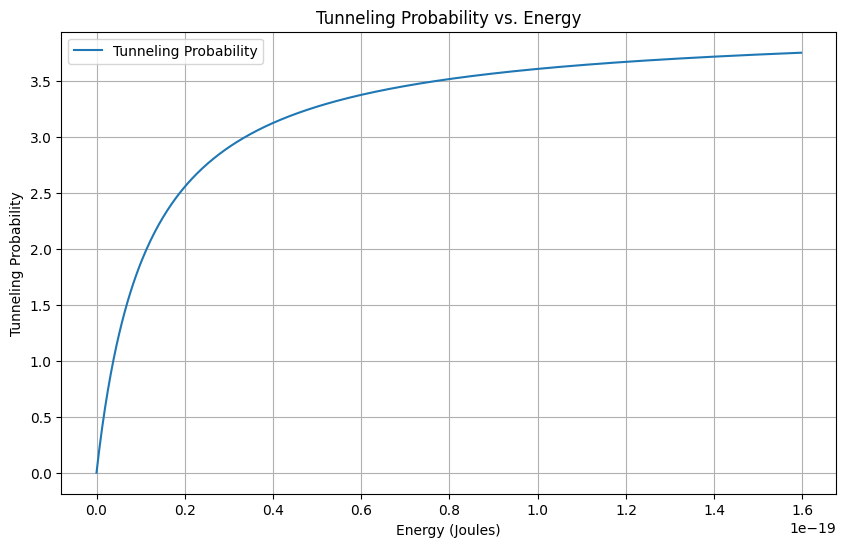

In [3]:
import numpy as np

# Constants
hbar = 1.0545718e-34  # Planck's constant over 2*pi (J*s)
m = 9.10938356e-31    # Mass of electron (kg)
a = 1e-10             # Width of the barrier (meters)
V0 = 1.6e-19          # Height of the barrier (Joules) ~ 1eV

def tunneling_probability(E, V0, a, m, hbar):
    k = np.sqrt(2 * m * E) / hbar
    q = np.sqrt(2 * m * (V0 - E)) / hbar

    numerator = 16 * k**2 * q**2
    denominator = (k**2 + q**2)**2 * np.sinh(q * a)**2 + 4 * k**2 * q**2

    T = numerator / denominator
    return T

# Example energy values (Joules)
E_values = np.linspace(0, V0, 500)
T_values = tunneling_probability(E_values, V0, a, m, hbar)

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(E_values, T_values, label='Tunneling Probability')
plt.xlabel('Energy (Joules)')
plt.ylabel('Tunneling Probability')
plt.title('Tunneling Probability vs. Energy')
plt.legend()
plt.grid(True)
plt.show()


## Quantum Tunneling, Part 3

Last time, we solved the problem of a rectangular potential barrier by deriving the tunneling probability of a quantum particle. Today, we will attempt to solve the problem numerically by simulating a particle hitting a potential barrier and, hopefully, tunneling through it.

One thing to note: the analytic solution from last time was that of a time-independent problem. However, writing a simulation to model the same case is, frankly, boring. Instead, let us simulate the time dependent problem represented by the Schrödinger equation:

$$ H\psi(x, t) = i\hbar\dfrac{\partial \psi(x, t)}{\partial t} $$

Moreover, instead of having the wave function $\psi(x, t)$ represent a plane wave solution, we will look at the time evolution of a localized Gaussian wave packet.

We then carry on as follows:

1. Discretize space using a uniformly spaced grid $x$ of step $dx$.
2. Initialize the wave function as a Gaussian packet. We first prepare a Gaussian distribution of deviation $\sigma_0$ centered at $x_0$, which we then multiply by a complex exponential representing the initial momentum $k_0$, and finally normalize:

   $$ \psi(x) = \frac{1}{\sqrt[4]{2 \pi \sigma^2}} e^{-\left(\frac{x - x_0}{2 \sigma}\right)^2} e^{i k_0 x} $$

3. Set up the potential as a zero array, except for the barrier which is located just to the right of the origin of the coordinate system.
4. Calculate the Hamiltonian matrix. Here we adopt the atomic unit system, in which the Hamiltonian assumes the simple form:

   $$ H = -\dfrac{1}{2}\Delta + V(x) $$

   The action of the Laplace operator on a generic function $f$ can be discretized according to the finite difference scheme:

   $$ \Delta f \approx \dfrac{f[x-\text{d}x] - 2f[x] + f[x + \text{d}x]}{\text{d}x^2} $$

   and hence the Laplace operator itself may be represented by the finite difference stencil $\left[1, -2, 1\right]$. Taking the potential into account as well, the discretized Hamiltonian takes the form of the matrix:

   $$ \dfrac{1}{2\text{d}x^2} \begin{pmatrix}
      2 & -1 &  &  \\
      -1 & 2 & -1 &  \\
       & -1 & 2 & -1 &  \\
       &  & -1 & \ddots
   \end{pmatrix} +
   \begin{pmatrix}
      V[0] &  &  &  \\
       & V[1] &  &  \\
       &  & V[2] &  &  \\
       &  &  & \ddots
   \end{pmatrix} $$

Finally, compute the time evolution operator. Given our differential equation:

$$ H\psi(x, t) = i\dfrac{\partial \psi(x, t)}{\partial t} $$

we can discretize it in time as:

$$ \dfrac{\psi(x, t + \text{d}t) -  \psi(x, t) }{\text{d}t}  \approx -i\,H\psi(x, t) $$

This is called the forward Euler method, or the explicit method, as we can easily express the value of the desired function at the next time step from its value at the current step. Likewise, we can carry out a backward Euler method by imposing:

$$ \dfrac{\psi(x, t + \text{d}t) -  \psi(x, t) }{\text{d}t}  \approx -i\,H\psi(x, t + \text{d}t) $$

This, instead, is an implicit formula — the value of the function at the next time step is present on both sides of the equation.

Combining these two methods yields the so-called Crank-Nicolson scheme, which combines adequate accuracy and stability, and incurs a relatively modest computational cost:

$$ \dfrac{\psi(x, t + \text{d}t) -  \psi(x, t) }{\text{d}t}  \approx \dfrac{1}{2i}\,H\psi(x, t) +  \dfrac{1}{2i}\,H\psi(x, t + \text{d}t) $$

$$ \psi(x, t + \text{d}t) -  \psi(x, t)   = \dfrac{ \text{d}t }{2i}\,H\psi(x, t) +  \dfrac{ \text{d}t }{2i}\,H\psi(x, t + \text{d}t) $$

$$ \left(1 -   \dfrac{ \text{d}t }{2i}\,H \right)   \psi(x, t + \text{d}t)  =  \left(1 + \dfrac{ \text{d}t }{2i}\,H\right)  \psi(x, t) $$

Isolating the value of $\psi(x, t + \text{d}t)$ we eventually get:

$$ \psi(x, t + \text{d}t) = \left(1 -   \dfrac{ \text{d}t }{2i}\,H \right)^{-1}   \left(1 + \dfrac{ \text{d}t }{2i}\,H\right)  \psi(x, t) $$

Thus, we create the implicit and explicit matrices. According to the documentation, the matrix to be inverted should be in the compressed sparse column (csc) format for maximum performance, hence we convert both matrices to the csc representation. However, matrix-vector multiplication is faster when the matrix is in the compressed sparse row (csr) format.

Now that we set everything up nicely, the method `evolve()`, which takes care of advancing the state of the system one step ahead in time, can be quite simple and straightforward:

We first compute the wave function at the next time step by applying the time evolution matrix to the previous wave function. What we are interested in, however, is the probability density — modulus square of the wave function. Before we return the density, we normalize both quantities.

### Animation

As we have done something very similar in a recent post, we will move quickly here. In the constructor, apart from setting up the figure, we plot the potential barrier (its height reduced, just for a nicer visual presentation), as well as display a timer.

The `update(data)` method simply updates the plot of the probability density. The actual data to be plotted at each time step is computed in the `time_step()` method. The return value of the wave_packet is yielded at each call of the method. We also take care of updating the time display. Note that we are working in atomic units in general, but convert to SI here for the sake of clarity. Finally, the `animate()` method takes care of creating the animation.



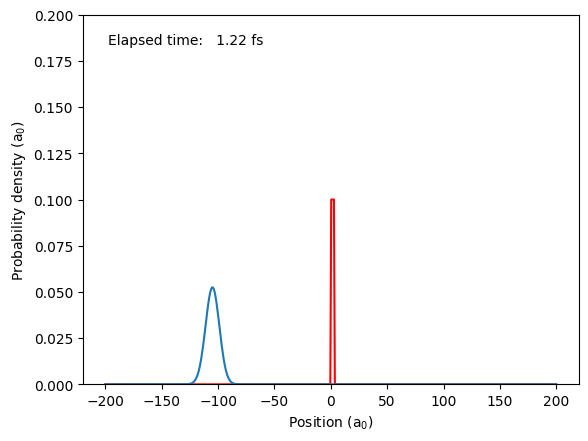

In [19]:
# Ensure all required packages are installed
!pip install celluloid

import matplotlib.pyplot as plt
import numpy as np
from scipy.sparse import linalg as ln
from scipy import sparse as sparse
import matplotlib.animation as animation
from IPython.display import HTML

class Wave_Packet:
    def __init__(self, n_points, dt, sigma0=5.0, k0=1.0, x0=-150.0, x_begin=-200.0,
                 x_end=200.0, barrier_height=1.0, barrier_width=3.0):
        self.n_points = n_points
        self.sigma0 = sigma0
        self.k0 = k0
        self.x0 = x0
        self.dt = dt
        self.prob = np.zeros(n_points)
        self.barrier_width = barrier_width
        self.barrier_height = barrier_height

        # 1) Space discretization
        self.x, self.dx = np.linspace(x_begin, x_end, n_points, retstep=True)

        # 2) Initialization of the wave function to Gaussian wave packet
        norm = (2.0 * np.pi * sigma0**2)**(-0.25)
        self.psi = np.exp(-(self.x - x0)**2 / (4.0 * sigma0**2)) * np.exp(1.0j * k0 * self.x)
        self.psi *= (2.0 * np.pi * sigma0**2)**(-0.25)

        # 3) Setting up the potential barrier
        self.potential = np.array(
            [barrier_height if 0.0 < x < barrier_width else 0.0 for x in self.x])

        # 4) Creating the Hamiltonian
        h_diag = np.ones(n_points) / self.dx**2 + self.potential
        h_non_diag = np.ones(n_points - 1) * (-0.5 / self.dx**2)
        hamiltonian = sparse.diags([h_diag, h_non_diag, h_non_diag], [0, 1, -1])

        # 5) Computing the Crank-Nicolson time evolution matrix
        implicit = (sparse.eye(self.n_points) - dt / 2.0j * hamiltonian).tocsc()
        explicit = (sparse.eye(self.n_points) + dt / 2.0j * hamiltonian).tocsc()
        self.evolution_matrix = ln.inv(implicit).dot(explicit).tocsr()

    def evolve(self):
        self.psi = self.evolution_matrix.dot(self.psi)
        self.prob = abs(self.psi)**2

        norm = sum(self.prob)
        self.prob /= norm
        self.psi /= norm**0.5

        return self.prob

class Animator:
    def __init__(self, wave_packet):
        self.time = 0.0
        self.wave_packet = wave_packet
        self.fig, self.ax = plt.subplots()
        plt.plot(self.wave_packet.x, self.wave_packet.potential * 0.1, color='r')

        self.time_text = self.ax.text(0.05, 0.95, '', horizontalalignment='left',
                                      verticalalignment='top', transform=self.ax.transAxes)
        self.line, = self.ax.plot(self.wave_packet.x, self.wave_packet.evolve())
        self.ax.set_ylim(0, 0.2)
        self.ax.set_xlabel('Position (a$_0$)')
        self.ax.set_ylabel('Probability density (a$_0$)')

    def update(self, data):
        self.line.set_ydata(data)
        return self.line,

    def time_step(self):
        while True:
            self.time += self.wave_packet.dt
            self.time_text.set_text(
                'Elapsed time: {:6.2f} fs'.format(self.time * 2.419e-2))
            yield self.wave_packet.evolve()

    def animate(self):
        self.ani = animation.FuncAnimation(
            self.fig, self.update, self.time_step, interval=500, blit=True,
            save_count=500, cache_frame_data=False)
        return self.ani

wave_packet = Wave_Packet(n_points=500, dt=0.1, barrier_width=3.0, barrier_height=1)
animator = Animator(wave_packet)
animation = animator.animate()
plt.rcParams['animation.embed_limit'] = 10000  # Increase the embed limit to 100 MB
HTML(animation.to_jshtml())
